<a href="https://colab.research.google.com/github/baiyunming/I2DL-WS2020/blob/main/Yolo_augmented_dataset.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import os
import torch
from google.colab import drive
from torch.utils.data import DataLoader
import torch.optim as optim
from tqdm.notebook import tqdm

In [ ]:
drive.mount('/content/drive')

Go to this URL in a browser: https://accounts.google.com/o/oauth2/auth?client_id=947318989803-6bn6qk8qdgf4n4g3pfee6491hc0brc4i.apps.googleusercontent.com&redirect_uri=urn%3aietf%3awg%3aoauth%3a2.0%3aoob&scope=email%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdocs.test%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive.photos.readonly%20https%3a%2f%2fwww.googleapis.com%2fauth%2fpeopleapi.readonly%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive.activity.readonly&response_type=code

Enter your authorization code:
4/1AY0e-g5lqm82URoo6lGhe2NBgxC9NuPgMPp7voMbj4D0qnm_CD0iGJPA_Vs


In [ ]:
%cd drive/MyDrive/ObjectDetection/

/content/drive/MyDrive/ObjectDetection


In [ ]:
from loss import YoloLoss
from animal_dataset import AnimalDataset
from utils import non_max_suppression, mean_average_precision, get_list_boxes, calculate_map

In [ ]:
%cd drive/MyDrive/ObjectDetection/model1

[Errno 2] No such file or directory: 'drive/MyDrive/ObjectDetection/model1'
/content/drive/MyDrive/ObjectDetection


In [ ]:
from model import YOLO_Resnet

In [ ]:
train_dataset = AnimalDataset("/content/drive/MyDrive/ObjectDetection/animal_dataset/train.csv")
train_batch_size = 32
train_dataloader = DataLoader(train_dataset, batch_size=train_batch_size, shuffle=True)

valid_dataset = AnimalDataset("/content/drive/MyDrive/ObjectDetection/animal_dataset/test.csv")
valid_batch_size = 16
valid_dataloader = DataLoader(valid_dataset, batch_size=valid_batch_size, shuffle=True)

In [ ]:
device = "cuda" if torch.cuda.is_available() else "cpu"
model = YOLO_Resnet().to(device)

Downloading: "https://download.pytorch.org/models/resnet50-19c8e357.pth" to /root/.cache/torch/hub/checkpoints/resnet50-19c8e357.pth


In [ ]:
optimizer = optim.Adam(model.parameters(), lr=2e-5)

In [ ]:
# Load the TensorBoard notebook extension
%load_ext tensorboard
from tensorflow import summary
import tensorflow as tf

In [ ]:
train_log_dir = './run/train'
train_summary_writer = summary.create_file_writer(train_log_dir)
val_log_dir = './run/validate'
val_summary_writer = summary.create_file_writer(val_log_dir)

In [ ]:
%tensorboard --logdir run

Reusing TensorBoard on port 6006 (pid 262), started 1:28:48 ago. (Use '!kill 262' to kill it.)

<IPython.core.display.Javascript object>

In [ ]:
def train(model, optimizer, image, label):
    model.train()
    batch_size = image.shape[0]

    criterion = YoloLoss()

    optimizer.zero_grad()

    input = image.to(device)
    target = label.to(device) 
    
    pred = model(input)
    loss = criterion(pred, target)/batch_size
    
    loss.backward()
       
    optimizer.step()

    return loss.item()

In [ ]:
def validate(model, image, label):
    model.eval()
    batch_size = image.shape[0]

    criterion = YoloLoss()

    optimizer.zero_grad()

    with torch.no_grad():
      input = image.to(device)
      target = label.to(device) 
    
      pred = model(input)
      loss = criterion(pred, target)/batch_size

    return loss.item()

In [17]:
max_epoch = 30
max_map = -1 
tmp_path = './checkpoint_dropout0.3.pth'
train_loss_full = []
valid_loss_full = []
train_map_full = []
valid_map_full = []

for epoch in tqdm(range(max_epoch)):
    train_loss = 0 
    train_map = 0
    valid_loss = 0
    valid_map = 0


    # Iterate over the train_dataloader
    with tqdm(total=len(train_dataloader)) as pbar:
        for idx, [image, label] in enumerate(train_dataloader):
          curr_loss = train(model, optimizer, image, label)
          train_loss += curr_loss / len(train_dataloader)
          pbar.update(1)

    checkpoint = {"state_dict": model.state_dict(),
            "optimizer": optimizer.state_dict(),}
    torch.save(checkpoint, tmp_path)

    train_map = calculate_map(model, train_dataloader, iou_threshold=0.4, confidence_threshold=0.5)
    
    train_loss_full.append(train_loss)
    train_map_full.append(train_map)

    with train_summary_writer.as_default():
        tf.summary.scalar('loss', train_loss, step=epoch)                
        tf.summary.scalar('map', train_map, step=epoch)     


    with tqdm(total=len(valid_dataloader)) as pbar:
        for idx, [image, label] in enumerate(valid_dataloader):
          curr_loss = validate(model, image, label)
          valid_loss += curr_loss / len(valid_dataloader)
          pbar.update(1)

    valid_map = calculate_map(model, valid_dataloader, iou_threshold=0.4, confidence_threshold=0.5)

    valid_loss_full.append(valid_loss)
    valid_map_full.append(valid_map)

    with val_summary_writer.as_default():
        tf.summary.scalar('loss', valid_loss, step=epoch)
        tf.summary.scalar('map', valid_map, step=epoch) 


    max_map = max(valid_map, max_map)
    if max_map == valid_map:
      filename = './best_model.pth'
      print("=> Saving checkpoint")
      torch.save(checkpoint, filename)

    #drive.flush_and_unmount()
    #drive.mount('/content/drive')

    print(train_loss, valid_loss)
    print(train_map, valid_map)



=> Saving checkpoint
3.581878652572631 1.528428418295724
tensor(0.6744) tensor(0.7095)



=> Saving checkpoint
3.328321161270142 1.534980765410832
tensor(0.7016) tensor(0.7406)



=> Saving checkpoint
3.2375412034988416 1.5132208211081368
tensor(0.7395) tensor(0.7518)



3.01428747177124 1.4887876680919103
tensor(0.7374) tensor(0.7180)



2.912564120292664 1.520065686532429
tensor(0.7659) tensor(0.7390)



2.787077779769897 1.4302122337477545
tensor(0.7923) tensor(0.7299)



2.648680863380432 1.4123596336160384
tensor(0.7982) tensor(0.6654)



2.590046138763427 1.4931762984820773
tensor(0.8178) tensor(0.7154)



2.5152292013168327 1.5337698715073722
tensor(0.8185) tensor(0.6989)



2.4211080980300896 1.5146515454564777
tensor(0.8380) tensor(0.7069)


KeyboardInterrupt: ignored

In [18]:
file_path = './best_model_newdataset_30epochs.pth'
checkpoint = torch.load(file_path)
best_model = YOLO_Resnet()
best_model.load_state_dict(checkpoint["state_dict"])

<All keys matched successfully>

In [19]:
best_model.to(device)

YOLO_Resnet(
  (backbone): Sequential(
    (0): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
    (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
    (4): Sequential(
      (0): Bottleneck(
        (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (relu): ReLU(inplace=True)
        (downsample): Sequential(
          (0): Conv2d

In [20]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.patches as patches

In [30]:
from torchvision import transforms

In [40]:
def plot_image(image, boxes):
    """Plots predicted bounding boxes on the image"""
    #im = transforms.ToPILImage()(image).convert("RGB")
    im = np.array(image)
    height, width, _ = im.shape

    # Create figure and axes
    fig, ax = plt.subplots(1)
    # Display the image
    ax.imshow(im)

    # box[0] is x midpoint, box[2] is width
    # box[1] is y midpoint, box[3] is height

    # Create a Rectangle potch
    for box in boxes:
        box = box[2:]
        assert len(box) == 4, "Got more values than in x, y, w, h, in a box!"
        upper_left_x = box[0] - box[2] / 2
        upper_left_y = box[1] - box[3] / 2
        rect = patches.Rectangle(
            (upper_left_x * width, upper_left_y * height),
            box[2] * width,
            box[3] * height,
            linewidth=1,
            edgecolor="r",
            facecolor="none",
        )
        # Add the patch to the Axes
        ax.add_patch(rect)

    plt.show()

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


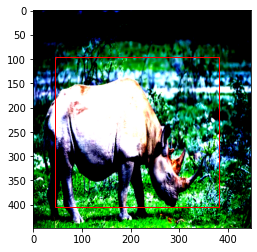

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


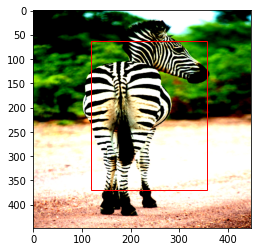

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


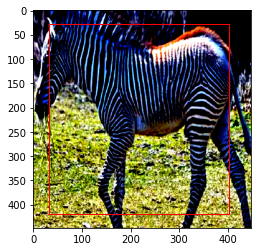

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


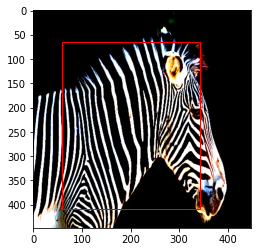

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


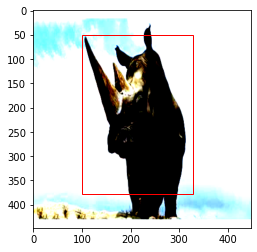

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


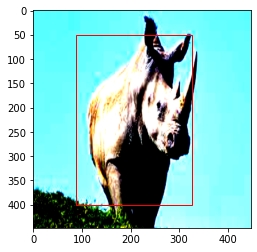

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


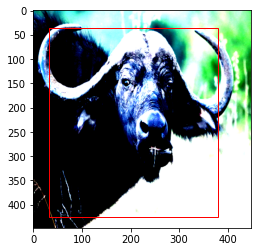

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


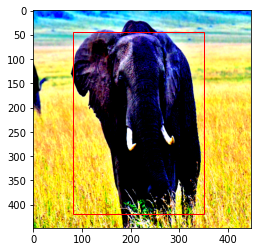

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


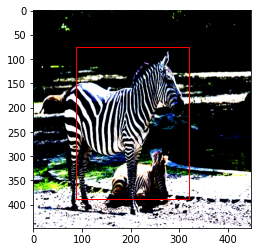

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


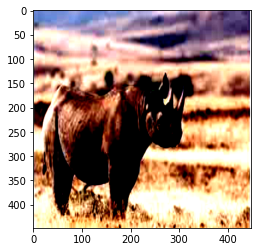

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


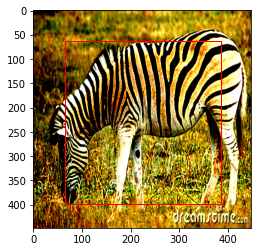

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


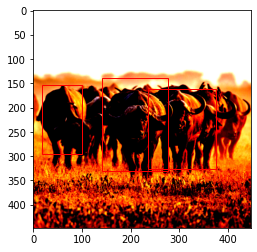

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


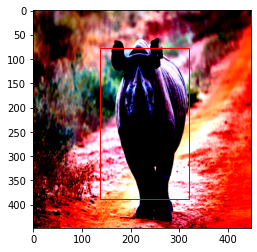

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


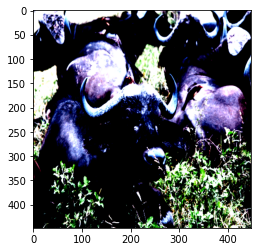

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


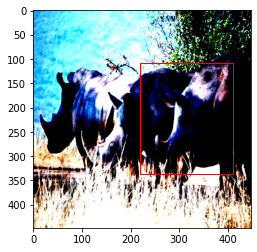

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


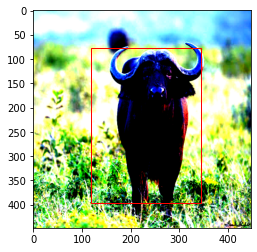

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


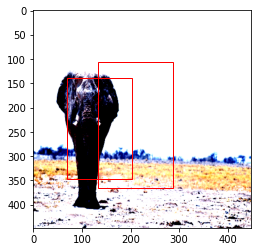

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


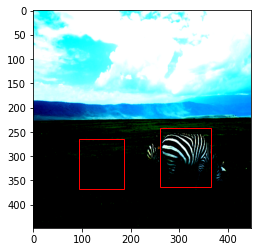

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


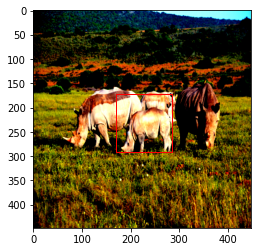

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


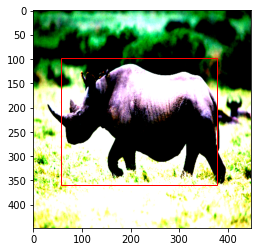

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


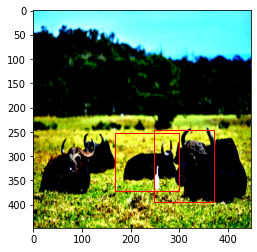

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


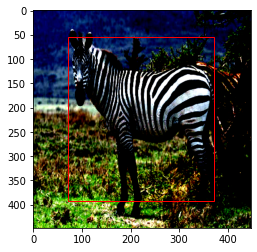

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


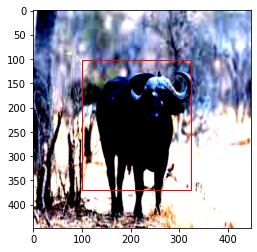

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


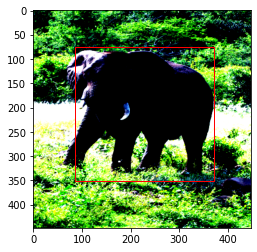

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


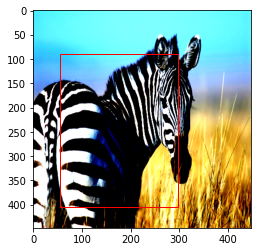

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


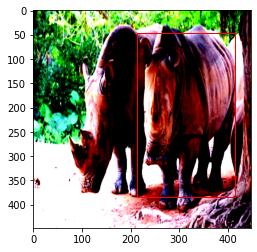

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


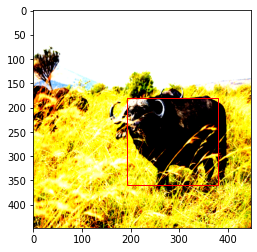

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


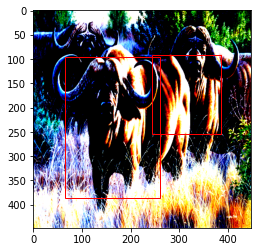

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


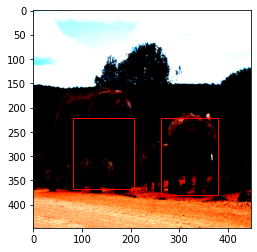

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


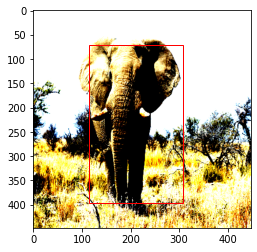

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


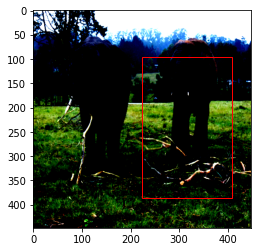

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


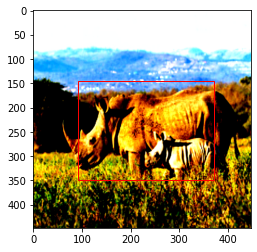

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


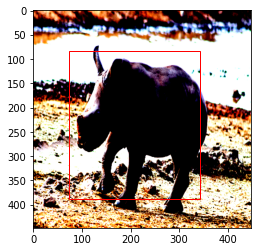

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


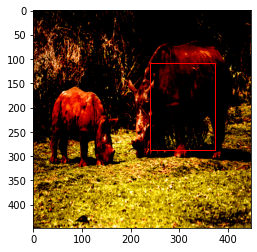

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


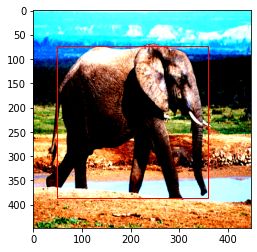

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


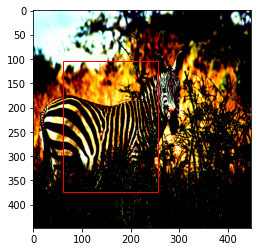

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


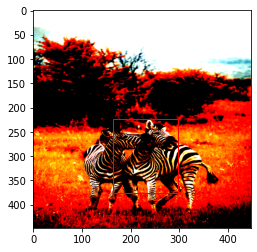

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


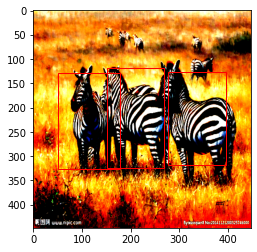

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


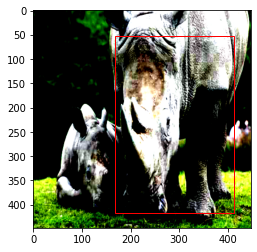

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


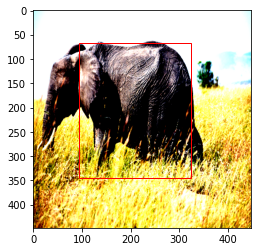

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


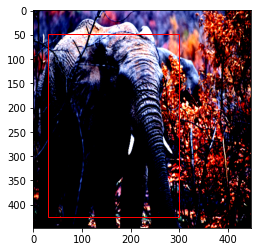

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


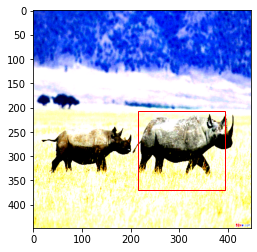

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


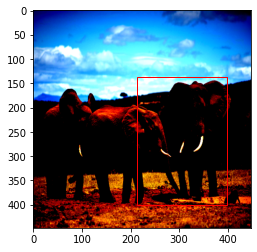

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


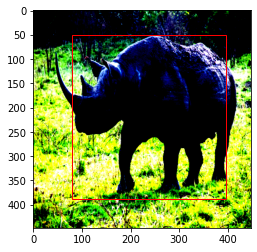

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


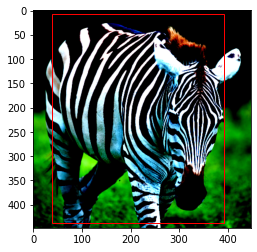

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


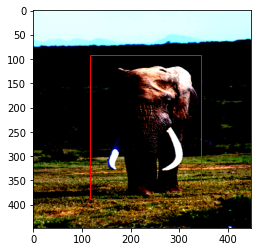

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


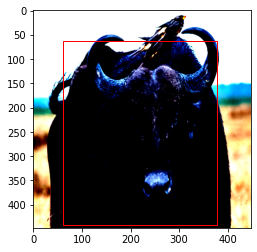

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


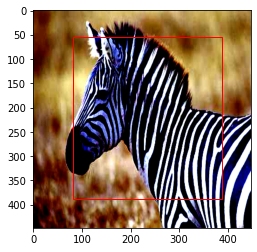

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


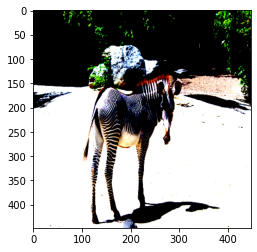

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


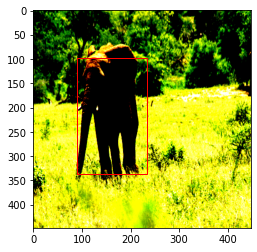

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


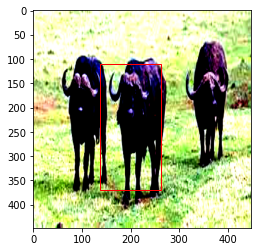

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


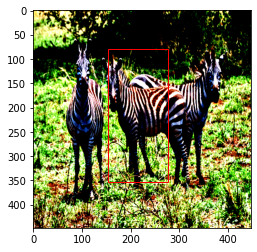

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


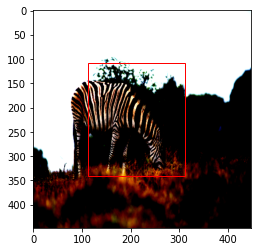

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


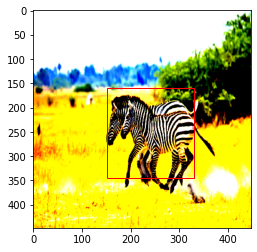

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


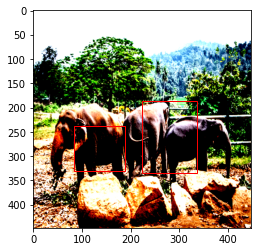

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


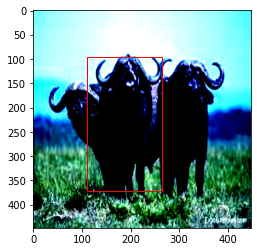

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


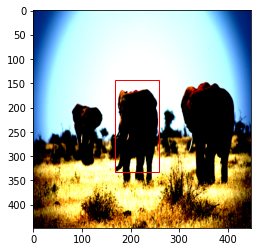

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


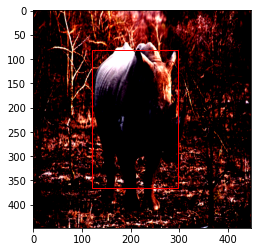

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


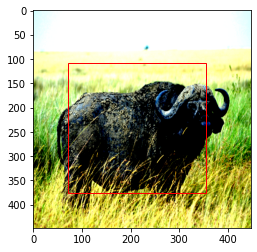

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


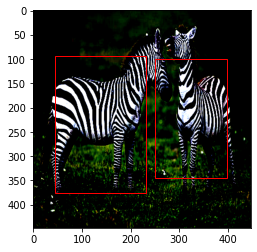

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


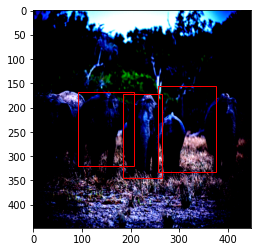

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


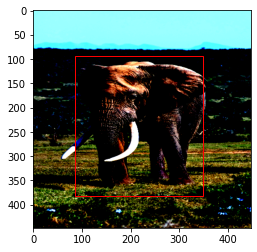

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


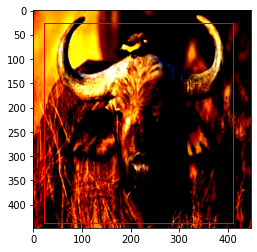

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


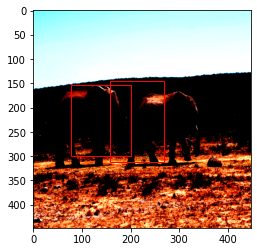

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


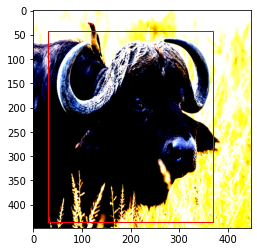

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


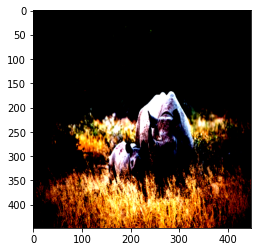

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


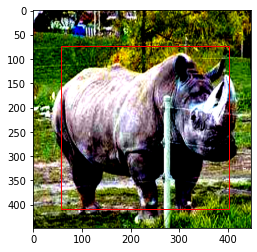

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


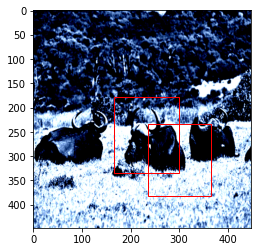

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


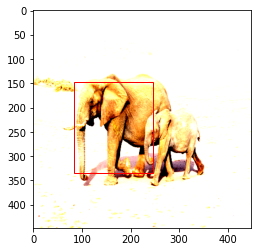

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


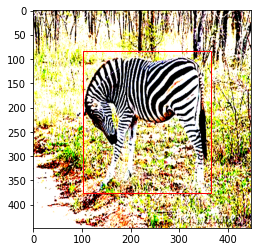

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


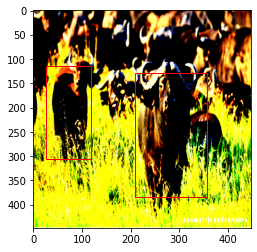

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


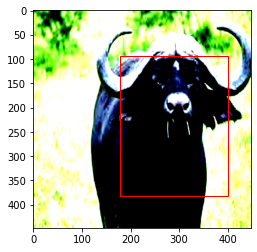

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


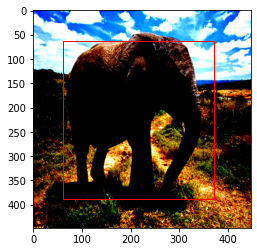

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


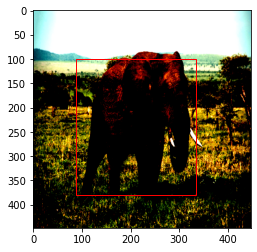

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


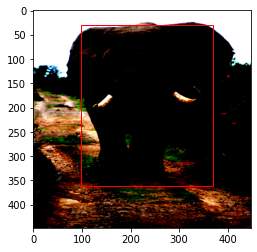

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


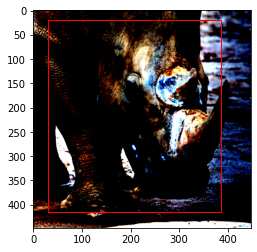

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


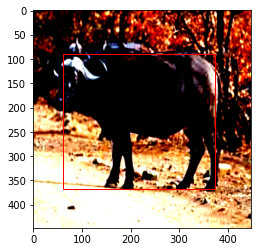

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


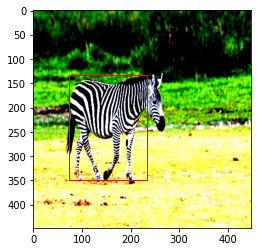

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


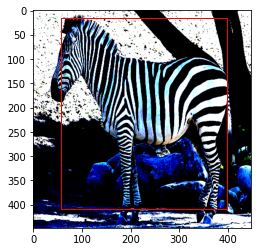

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


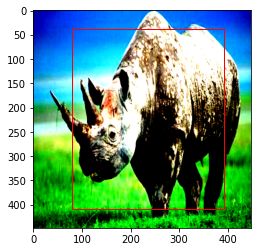

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


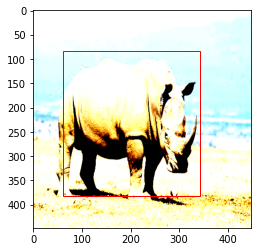

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


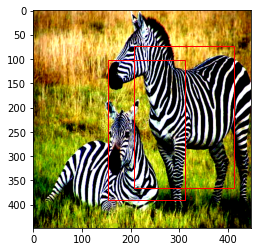

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


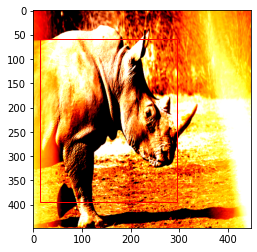

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


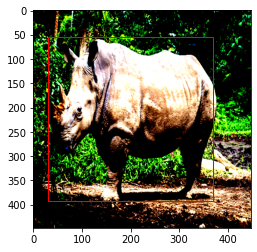

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


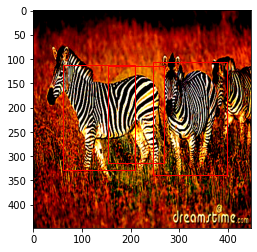

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


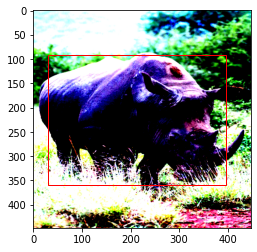

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


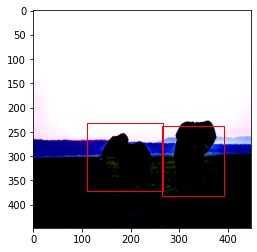

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


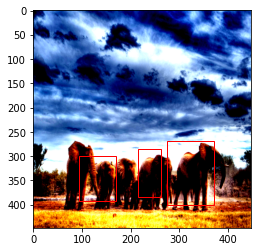

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


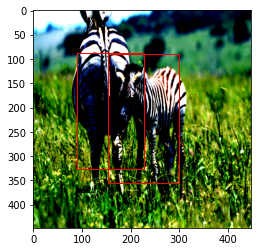

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


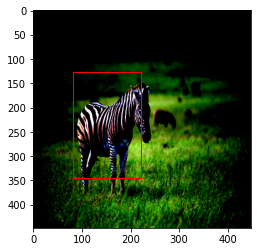

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


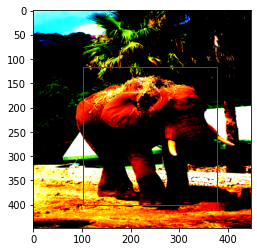

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


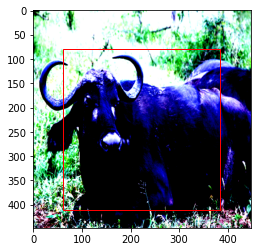

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


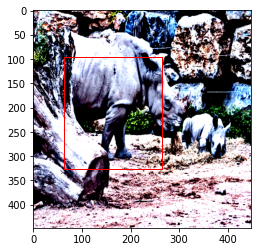

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


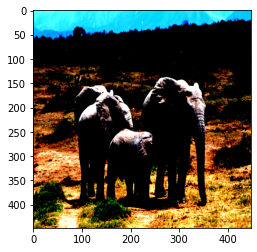

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


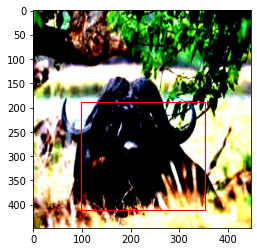

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


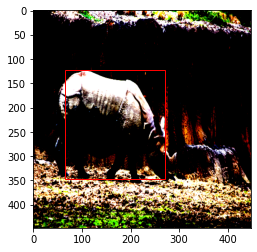

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


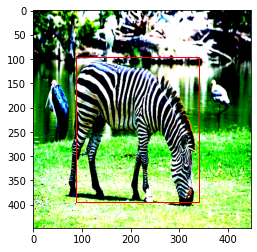

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


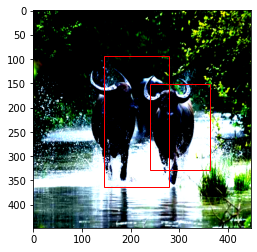

In [41]:
for x, y in valid_dataloader:
  x = x.to(device)
  for idx in range(7):
    bboxes = get_list_boxes(model(x), S=5)
    bboxes = non_max_suppression(bboxes[idx], 0.4, 0.5)
    plot_image(x[idx].permute(1,2,0).to("cpu"), bboxes)
    #plot_image(x[idx].to("cpu"), bboxes)

In [ ]:
|checkpoint = {"state_dict": model.state_dict(),
        "optimizer": optimizer.state_dict(),}

In [ ]:
filename = "my_checkpoint.pth.tar"
print("=> Saving checkpoint")
torch.save(checkpoint, filename)

=> Saving checkpoint
